In [1]:
%load_ext autoreload
%autoreload 2

import pymc as pm
import seaborn as sns
import pandas as pd
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
import numpy as np
import arviz as az
from matplotlib import pyplot as plt

import sys
sys.path.append('..')
from pfas_prep import PFAS
from PyPKMC import PyPKMC
import register_pfas_data as rpd

In [2]:
chemical = 'PFOS'
pfas_db = '../PFAS.db'
pfas_tmp = PFAS(pfas_db, pfas_file = '../auxiliary/pfas_master.csv')#, hero_only=1289834) # 
Vdss_prior = {'mu': -1.5, 'sd': 1.5}
CLC_prior = {'mu': -2.89, 'sd': 2.68}
load_trace = False

# Rat fits

## Male

First import the data using the old PFAS class

In [3]:
%%time
pfas_male_data = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='rat')
pfas_male_data.head()

Hero ID available:  [1289832 3749289 3859701 5387170]
dropping duplicated column
Hero ID used:  [1289832 3749289 3859701 5387170]
CPU times: user 880 ms, sys: 4.84 ms, total: 884 ms
Wall time: 887 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,time_course,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,1289832,45,-1,3,-1.0,NaN,0.300148,NaN,rat,sprague-dawley,4.2,mg/kg,1.0,hour,8.861205,1.280620,1,ug/ml,gavage,plasma,Male,DTXSID3031864,Figure 1,9.0,weeks,300.0,grams,3,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,5,0,0,0,0.041667,4.2,64.057796,0.300148,8.861205,2.218099,0.0,-1,0,1,0,0.246522,2.151296,0.250316,False,1.26062,1289832-4.2 mg/kg-gavage
1,1289832,45,-1,3,-1.0,NaN,0.300148,NaN,rat,sprague-dawley,4.2,mg/kg,2.0,hour,9.651667,1.961887,1,ug/ml,gavage,plasma,Male,DTXSID3031864,Figure 1,9.0,weeks,300.0,grams,3,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,5,0,0,0,0.083333,4.2,64.099462,0.300295,9.651667,3.398088,0.0,-1,0,1,0,0.341839,2.208704,0.352073,False,1.26062,1289832-4.2 mg/kg-gavage
2,1289832,45,-1,3,-1.0,NaN,0.300148,NaN,rat,sprague-dawley,4.2,mg/kg,6.0,hour,11.995872,0.326942,1,ug/ml,gavage,plasma,Male,DTXSID3031864,Figure 1,9.0,weeks,300.0,grams,3,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,5,0,0,0,0.250000,4.2,64.266129,0.300886,11.995872,0.566279,0.0,-1,0,1,0,0.047180,2.483450,0.047206,False,1.26062,1289832-4.2 mg/kg-gavage
3,1289832,45,-1,3,-1.0,NaN,0.300148,NaN,rat,sprague-dawley,4.2,mg/kg,12.0,hour,13.332412,0.463249,1,ug/ml,gavage,plasma,Male,DTXSID3031864,Figure 1,9.0,weeks,300.0,grams,3,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,5,0,0,0,0.500000,4.2,64.516129,0.301771,13.332412,0.802371,0.0,-1,0,1,0,0.060128,2.588390,0.060182,False,1.26062,1289832-4.2 mg/kg-gavage
4,1289832,45,-1,3,-1.0,NaN,0.300148,NaN,rat,sprague-dawley,4.2,mg/kg,1.0,day,14.615777,0.980893,1,ug/ml,gavage,plasma,Male,DTXSID3031864,Figure 1,9.0,weeks,300.0,grams,3,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,5,0,0,0,1.000000,4.2,65.016129,0.303543,14.615777,1.698956,0.0,-1,0,1,0,0.115851,2.675391,0.116241,False,1.26062,1289832-4.2 mg/kg-gavage


### Run the models

#### 1-Compartment model

Divergences are introduced when prior for (kappa - 2) ~ gamma(0.01, 0.01) and go away when (kappa - 2) ~ gamma(0.1, 0.1)

In [4]:
pfas_male_1cmpt = PyPKMC(pfas_male_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOS_Male_rat_1cmpt
hierarchical model, 1-compartment


Sampling: [conc_indiv, conc_summary, fa, kappaMinusTwo, lnCLC_offset, lnVd_offset, lnk_abs_offset, mu_fa, mu_lnCLC, mu_lnVd, mu_lnk_abs, sigma, sigma_lnCLC, sigma_lnVd, sigma_lnk_abs]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

2024-08-14 14:05:11.175880: E external/xla/xla/service/slow_operation_alarm.cc:65] Constant folding an instruction is taking > 1s:

  %reduce = f64[4,5000,246]{2,1,0} reduce(f64[4,5000,1,246]{3,2,1,0} %broadcast.34, f64[] %constant.39), dimensions={2}, to_apply=%region_1.98, metadata={op_name="jit(process_fn)/jit(main)/reduce_prod[axes=(2,)]" source_file="/data/tzurlind/tmp/tmptsvkxq_6" source_line=59}

This isn't necessarily a bug; constant-folding is inherently a trade-off between compilation time and speed at runtime. XLA has some guards that attempt to keep constant folding from taking too long, but fundamentally you'll always be able to come up with an input program that takes a long time.

If you'd like to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
2024-08-14 14:05:23.136127: E external/xla/xla/service/slow_operation_alarm.cc:133] The operation took 12.960397073s
Constant folding an instruction is taking > 1s:

  %reduce = f64[4,5000,246]

Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (45), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


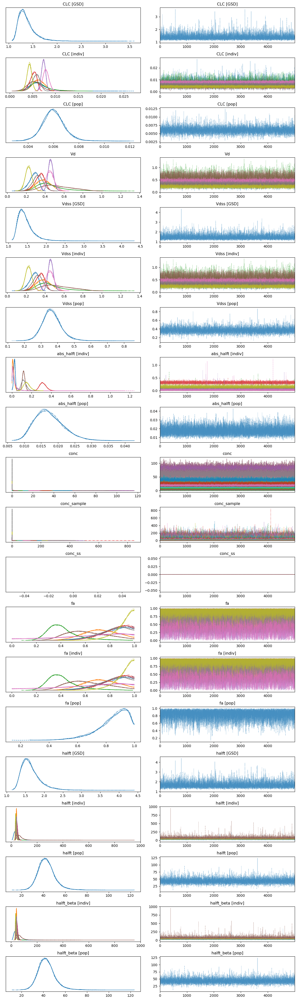

In [5]:
with pfas_male_1cmpt.model:
    az.plot_trace(pfas_male_1cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


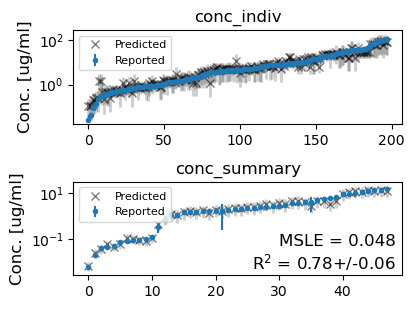

In [6]:
pfas_male_1cmpt.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [7]:
pfas_male_2cmpt = PyPKMC(pfas_male_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_2cmpt.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOS_Male_rat_2cmpt
hierarchical model, 2-compartment


Sampling: [conc_indiv, conc_summary, fa, kappaMinusTwo, lnCLC_offset, lnR_offset, lnVdss_offset, lnk_abs_offset, lnk_cd_offset, mu_fa, mu_lnCLC, mu_lnR, mu_lnVdss, mu_lnk_abs, mu_lnk_cd, sigma, sigma_lnCLC, sigma_lnR, sigma_lnVdss, sigma_lnk_abs, sigma_lnk_cd]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (83), generating only 20 plots
  warnings.warn(


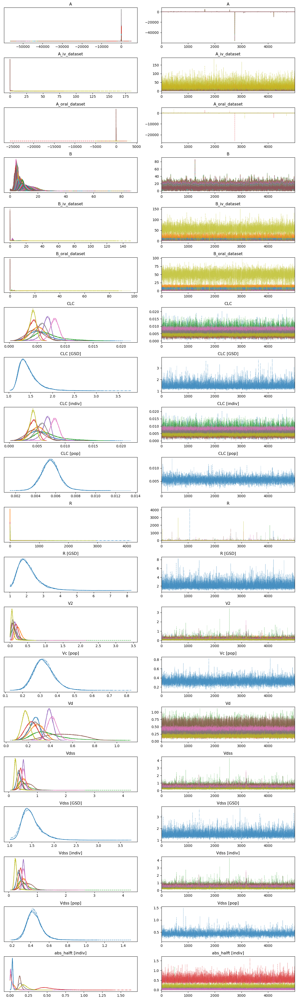

In [8]:
with pfas_male_2cmpt.model:
    az.plot_trace(pfas_male_2cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


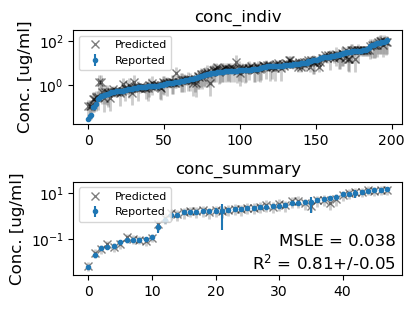

In [9]:
pfas_male_2cmpt.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-465.801016,51.478914,0.000000,0.92844,52.259833,0.000000,True,log
1_compartment,1,-495.606177,44.472693,29.805161,0.07156,52.933760,8.616936,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

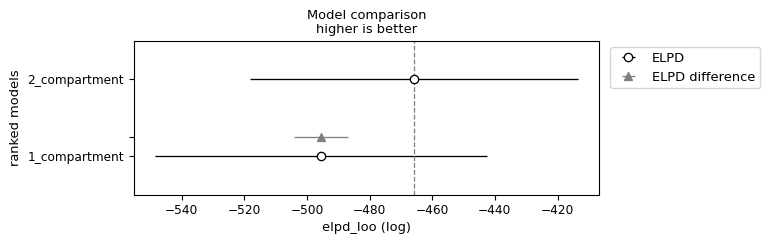

In [10]:
pfas_male_compare = az.compare({"1_compartment": pfas_male_1cmpt._trace, "2_compartment": pfas_male_2cmpt._trace},
                           var_name="combined",ic='loo')
display(pfas_male_compare)
az.plot_compare(pfas_male_compare, insample_dev=False)

#### Define winning model

In [87]:
pfas_male = pfas_male_2cmpt
print(pfas_male.N_divergences)
print(f'Pass all metrics = {pfas_male.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


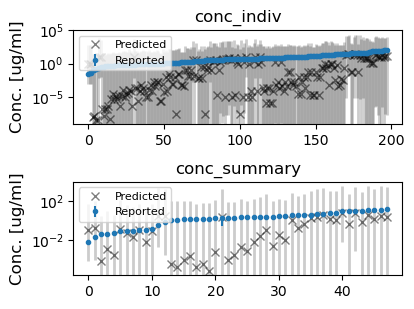

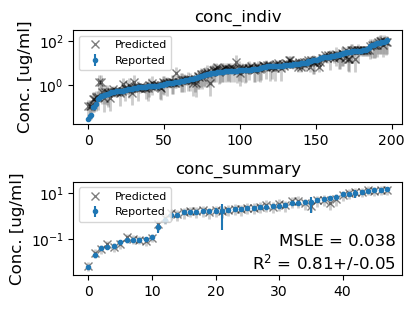

In [12]:
pfas_male.plot_data_ppc(group='prior', savefig=True)
pfas_male.plot_data_ppc(group='posterior', savefig=True)

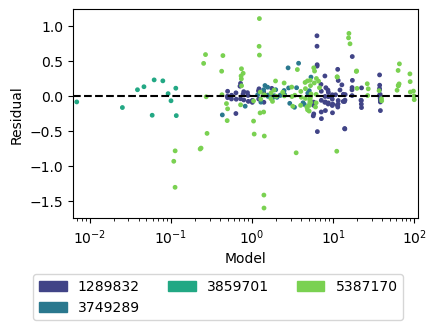

In [13]:
pfas_male.plot_residuals() 

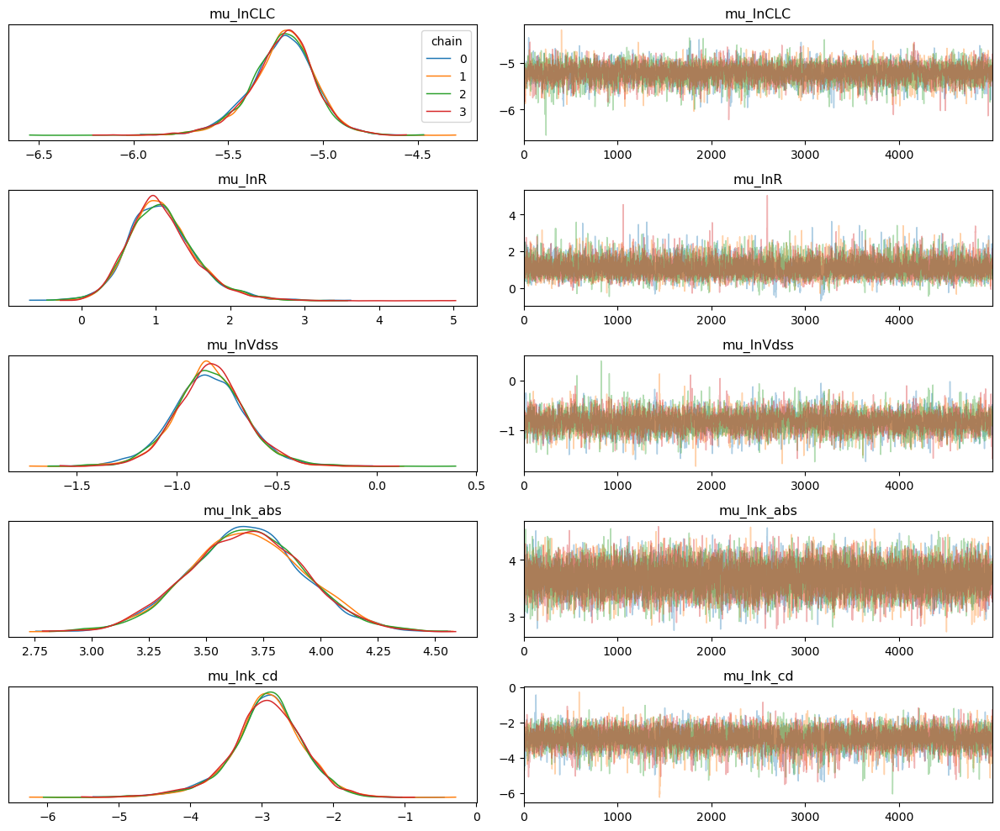

In [14]:
trace_model = pfas_male
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/rat/PFOS/PFOS_Male_rat_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


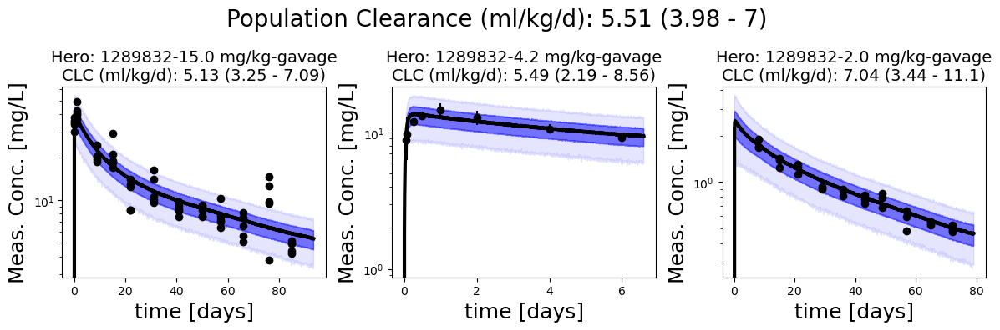

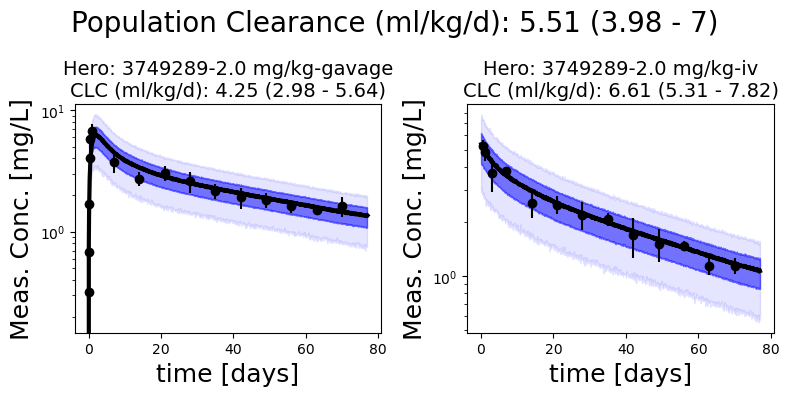

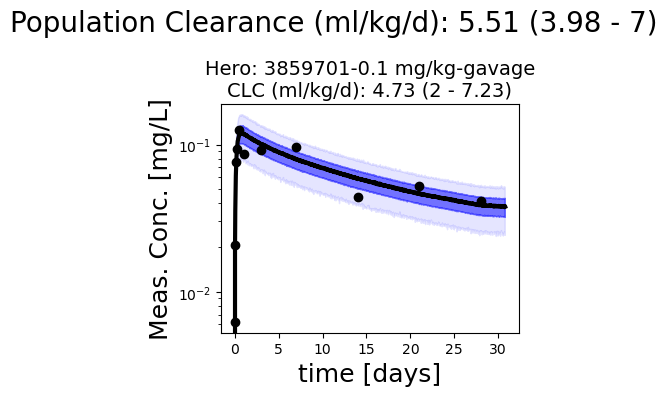

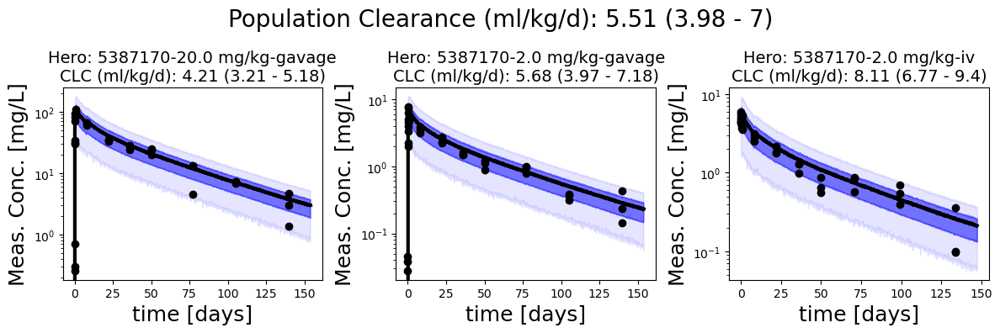

In [15]:
pfas_male.plot_all_studies()

### PK stats

In [16]:
pfas_male.get_pk_stats() # 2cmpt

,mean,sd,hdi_5%,hdi_95%
CLC [pop],0.00551,0.00094,0.00398,0.00699
Vc [pop],0.32436,0.06041,0.22519,0.41577
Vdss [pop],0.44193,0.08318,0.30931,0.56493
abs_halft [pop],0.01814,0.00462,0.01079,0.02515
fa [pop],0.85259,0.10819,0.70360,0.99712
halft [pop],57.07478,14.48185,35.63525,76.55418
halft_alpha [pop],3.82485,3.15739,0.60293,6.68880
halft_beta [pop],59.26778,17.26965,36.75336,80.31765


## Female

In [17]:
%%time
pfas_female_data = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='rat')
pfas_female_data.head()

Hero ID available:  [1289832 3749289 3859701 5387170]
dropping duplicated column
Hero ID used:  [1289832 3749289 5387170]
CPU times: user 769 ms, sys: 6.87 ms, total: 776 ms
Wall time: 777 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,time_course,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,1289832,46,7R204,1,-1.0,NaN,0.202462,NaN,rat,sprague-dawley,15.0,mg/kg,4.0,hour,30.264763,0.0,0,ug/ml,gavage,serum,Female,DTXSID3031864,Figure 3,9.0,weeks,NaN,Not Reported,3,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,16,0,0,0,0.166667,15.0,63.166667,0.202462,30.264763,0.0,0.0,-1,0,1,1,0.0,3.409984,0.0,True,3.036929,1289832-15.0 mg/kg-gavage
1,1289832,46,7R205,1,-1.0,NaN,0.202462,NaN,rat,sprague-dawley,15.0,mg/kg,4.0,hour,40.768867,0.0,0,ug/ml,gavage,serum,Female,DTXSID3031864,Figure 3,9.0,weeks,NaN,Not Reported,3,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,16,0,0,0,0.166667,15.0,63.166667,0.202462,40.768867,0.0,0.0,-1,0,1,1,0.0,3.707919,0.0,True,3.036929,1289832-15.0 mg/kg-gavage
2,1289832,46,7R206,1,-1.0,NaN,0.202462,NaN,rat,sprague-dawley,15.0,mg/kg,4.0,hour,29.608985,0.0,0,ug/ml,gavage,serum,Female,DTXSID3031864,Figure 3,9.0,weeks,NaN,Not Reported,3,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,16,0,0,0,0.166667,15.0,63.166667,0.202462,29.608985,0.0,0.0,-1,0,1,1,0.0,3.388078,0.0,True,3.036929,1289832-15.0 mg/kg-gavage
3,1289832,46,7R207,1,-1.0,NaN,0.202462,NaN,rat,sprague-dawley,15.0,mg/kg,4.0,hour,30.449712,0.0,0,ug/ml,gavage,serum,Female,DTXSID3031864,Figure 3,9.0,weeks,NaN,Not Reported,3,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,16,0,0,0,0.166667,15.0,63.166667,0.202462,30.449712,0.0,0.0,-1,0,1,1,0.0,3.416077,0.0,True,3.036929,1289832-15.0 mg/kg-gavage
4,1289832,46,7R208,1,-1.0,NaN,0.202462,NaN,rat,sprague-dawley,15.0,mg/kg,4.0,hour,34.934850,0.0,0,ug/ml,gavage,serum,Female,DTXSID3031864,Figure 3,9.0,weeks,NaN,Not Reported,3,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,16,0,0,0,0.166667,15.0,63.166667,0.202462,34.934850,0.0,0.0,-1,0,1,1,0.0,3.553485,0.0,True,3.036929,1289832-15.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [18]:
pfas_female_1cmpt = PyPKMC(pfas_female_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOS_Female_rat_1cmpt
hierarchical model, 1-compartment


Sampling: [conc_indiv, conc_summary, fa, kappaMinusTwo, lnCLC_offset, lnVd_offset, lnk_abs_offset, mu_fa, mu_lnCLC, mu_lnVd, mu_lnk_abs, sigma, sigma_lnCLC, sigma_lnVd, sigma_lnk_abs]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (45), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


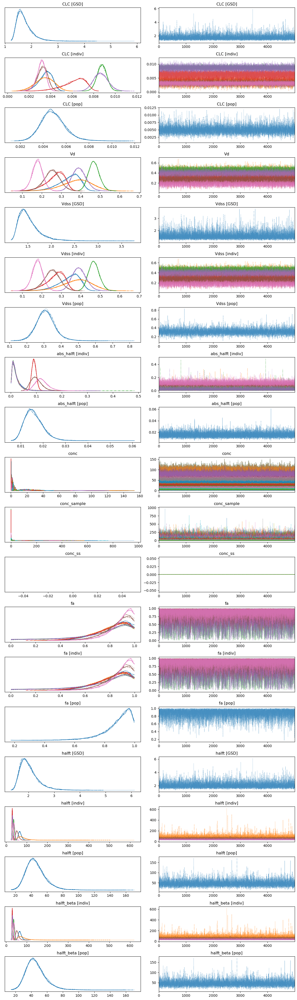

In [19]:
with pfas_female_1cmpt.model:
    az.plot_trace(pfas_female_1cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


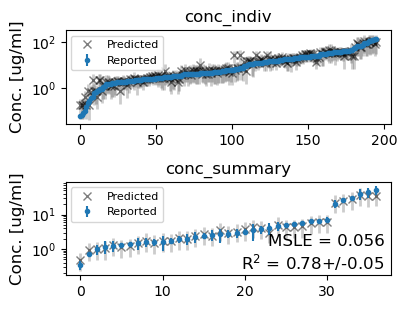

In [20]:
pfas_female_1cmpt.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [21]:
pfas_female_2cmpt = PyPKMC(pfas_female_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOS_Female_rat_2cmpt
hierarchical model, 2-compartment


Sampling: [conc_indiv, conc_summary, fa, kappaMinusTwo, lnCLC_offset, lnR_offset, lnVdss_offset, lnk_abs_offset, lnk_cd_offset, mu_fa, mu_lnCLC, mu_lnR, mu_lnVdss, mu_lnk_abs, mu_lnk_cd, sigma, sigma_lnCLC, sigma_lnR, sigma_lnVdss, sigma_lnk_abs, sigma_lnk_cd]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (83), generating only 20 plots
  warnings.warn(


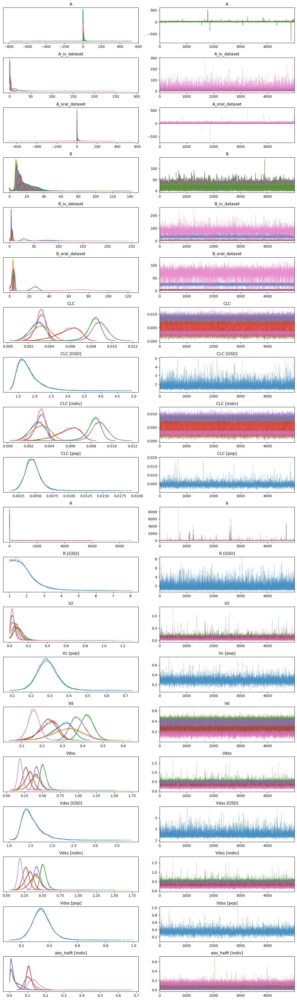

In [22]:
with pfas_female_2cmpt.model:
    az.plot_trace(pfas_female_2cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


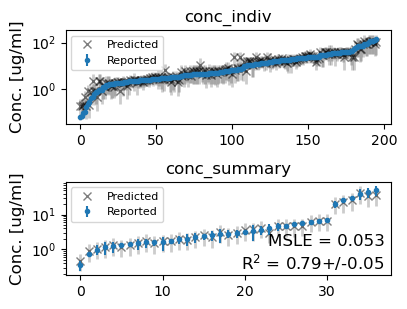

In [23]:
pfas_female_2cmpt.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-730.999402,31.284179,0.000000,1.000000e+00,52.543932,0.000000,False,log
1_compartment,1,-741.830854,30.506267,10.831452,5.346834e-13,53.316005,3.378032,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

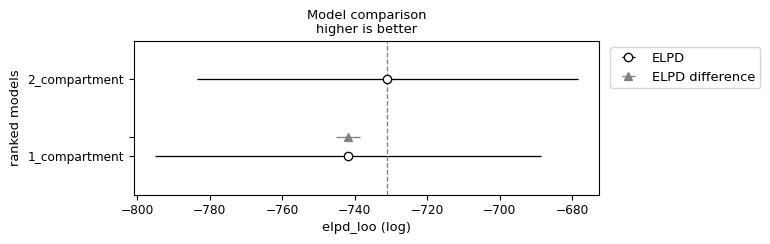

In [24]:
pfas_female_compare = az.compare({"1_compartment": pfas_female_1cmpt._trace, "2_compartment": pfas_female_2cmpt._trace},
                           var_name="combined",ic='loo')
display(pfas_female_compare)
az.plot_compare(pfas_female_compare, insample_dev=False)

#### Define winning model

In [88]:
pfas_female = pfas_female_2cmpt
print(pfas_female.N_divergences)
print(f'Pass all metrics = {pfas_female.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


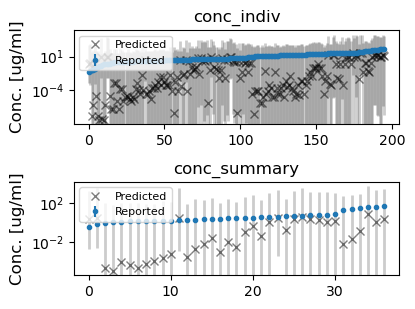

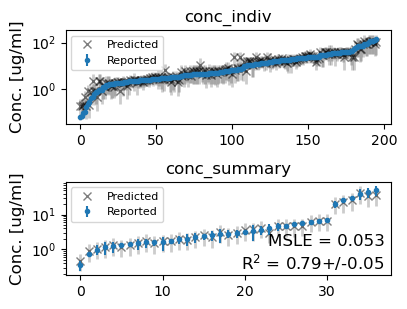

In [26]:
pfas_female.plot_data_ppc(group='prior', savefig=True)
pfas_female.plot_data_ppc(group='posterior', savefig=True)

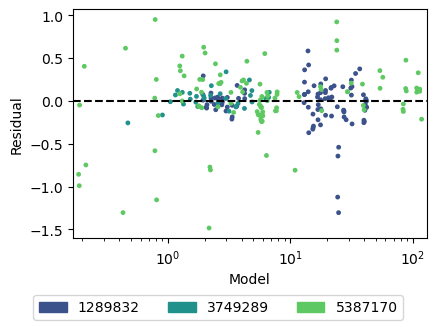

In [27]:
pfas_female.plot_residuals() 

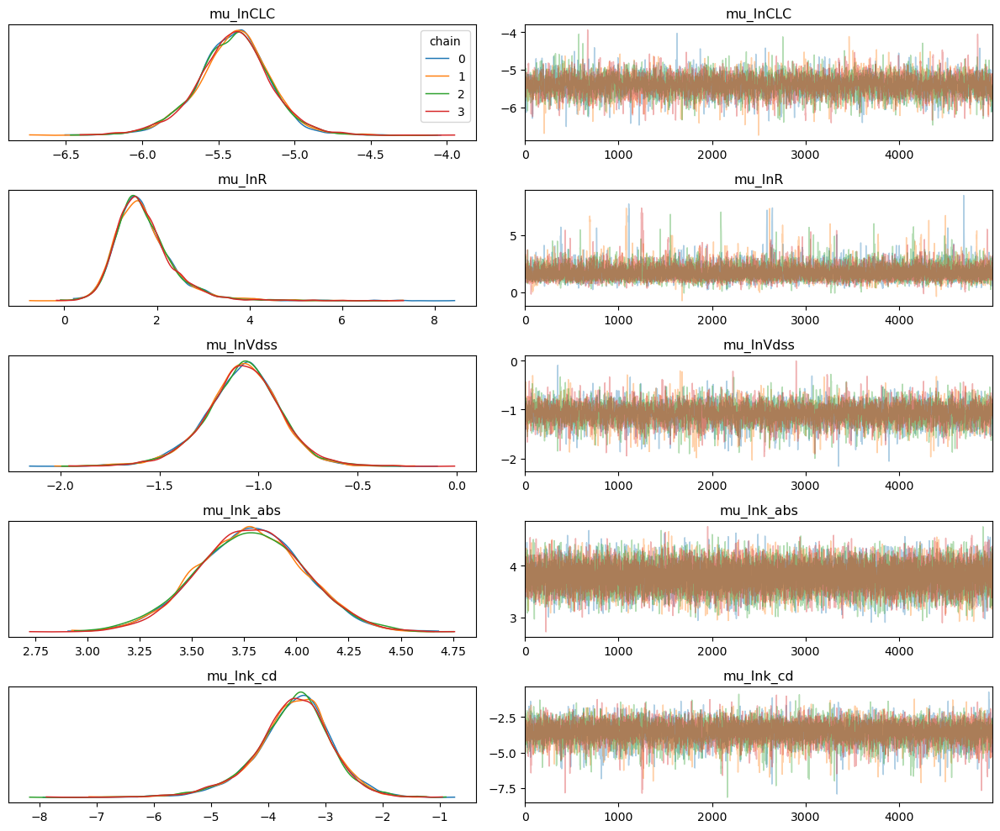

In [28]:
trace_model = pfas_female
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/rat/PFOS/PFOS_Female_rat_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


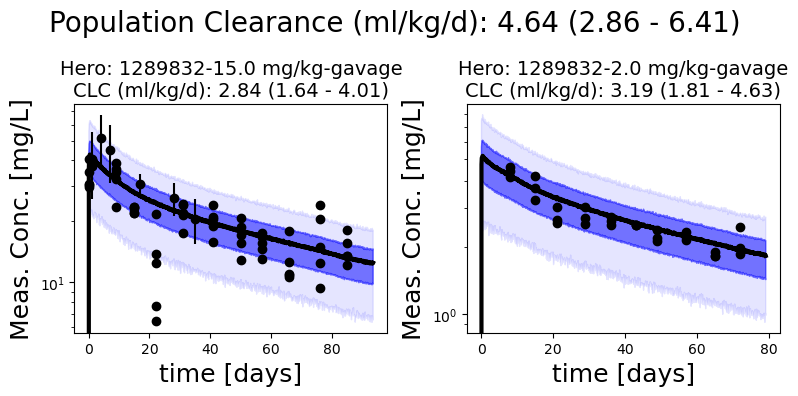

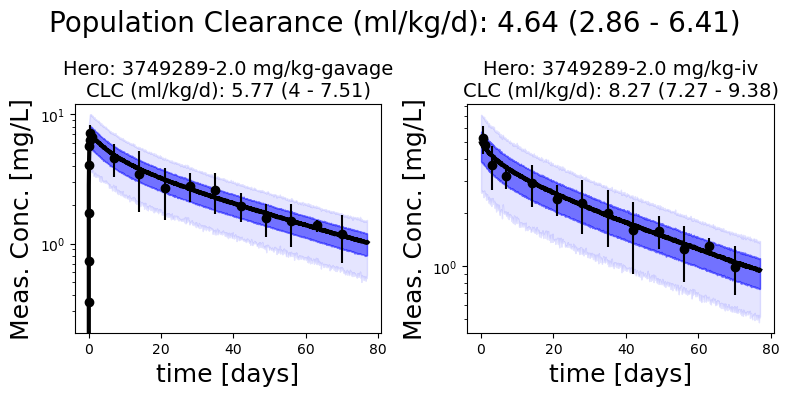

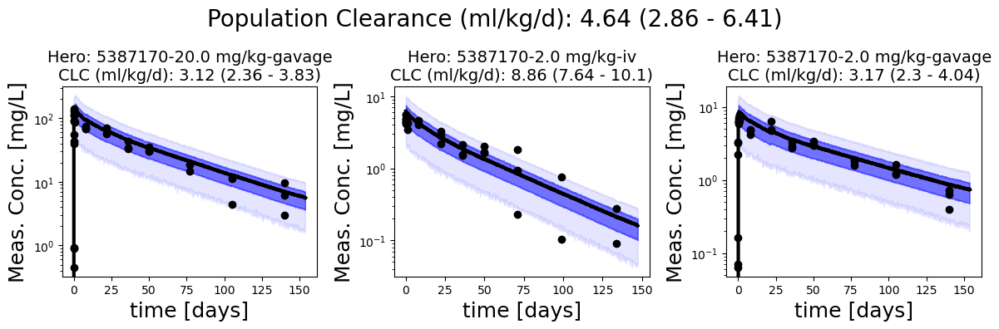

In [29]:
pfas_female.plot_all_studies()

### PK stats

In [30]:
pfas_female.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],0.00464,0.00117,0.00286,0.00641
Vc [pop],0.28690,0.05624,0.19919,0.37742
Vdss [pop],0.34566,0.06754,0.23658,0.44831
abs_halft [pop],0.01634,0.00424,0.00964,0.02272
fa [pop],0.88457,0.09595,0.75580,0.99870
halft [pop],54.73396,17.70396,28.52479,80.35500
halft_alpha [pop],4.62459,4.15751,0.20504,8.57502
halft_beta [pop],56.52040,23.24147,28.81570,82.43987


# Mouse

## Male

In [31]:
%%time
pfas_male_data_mouse = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='mouse')
pfas_male_data_mouse.head()

Hero ID available:  [1289832 3749289 3859701 5387170]
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
dropping duplicated column
Hero ID used:  [1289832]
CPU times: user 79.2 ms, sys: 4.29 ms, total: 83.4 ms
Wall time: 82.2 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,1289832,47,-1,4,-1.0,NaN,0.031,NaN,mouse,CD-1,1.0,mg/kg,1.0,day,3.977591,0.224090,1,ug/ml,gavage,serum,Male,DTXSID3031864,Figure 7,9.0,weeks,NaN,Not Reported,4,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,8,0,0,0,1.0,1.0,0.031,3.977591,0.448179,0.0,-1,0,1,0,0.112321,1.374368,0.112676,False,0.031,1289832-1.0 mg/kg-gavage
1,1289832,47,-1,4,-1.0,NaN,0.031,NaN,mouse,CD-1,1.0,mg/kg,8.0,day,3.058824,0.112045,1,ug/ml,gavage,serum,Male,DTXSID3031864,Figure 7,9.0,weeks,NaN,Not Reported,4,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,8,0,0,0,8.0,1.0,0.031,3.058824,0.224090,0.0,-1,0,1,0,0.073162,1.115354,0.073260,False,0.031,1289832-1.0 mg/kg-gavage
2,1289832,47,-1,4,-1.0,NaN,0.031,NaN,mouse,CD-1,1.0,mg/kg,15.0,day,2.543417,0.112045,1,ug/ml,gavage,serum,Male,DTXSID3031864,Figure 7,9.0,weeks,NaN,Not Reported,4,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,8,0,0,0,15.0,1.0,0.031,2.543417,0.224090,0.0,-1,0,1,0,0.087935,0.929642,0.088106,False,0.031,1289832-1.0 mg/kg-gavage
3,1289832,47,-1,4,-1.0,NaN,0.031,NaN,mouse,CD-1,1.0,mg/kg,22.0,day,2.072829,0.134454,1,ug/ml,gavage,serum,Male,DTXSID3031864,Figure 7,9.0,weeks,NaN,Not Reported,4,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,8,0,0,0,22.0,1.0,0.031,2.072829,0.268908,0.0,-1,0,1,0,0.129189,0.720570,0.129730,False,0.031,1289832-1.0 mg/kg-gavage
4,1289832,47,-1,4,-1.0,NaN,0.031,NaN,mouse,CD-1,1.0,mg/kg,36.0,day,1.669468,0.112045,1,ug/ml,gavage,serum,Male,DTXSID3031864,Figure 7,9.0,weeks,NaN,Not Reported,4,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,8,0,0,0,36.0,1.0,0.031,1.669468,0.224090,0.0,-1,0,1,0,0.133629,0.503576,0.134228,False,0.031,1289832-1.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [32]:
pfas_male_1cmpt_mouse = PyPKMC(pfas_male_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior, pop_SD_prior=0.2)
pfas_male_1cmpt_mouse.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=12000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOS_Male_mouse_1cmpt
single level model, 1-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnVd, lnk_abs, sigma]


  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


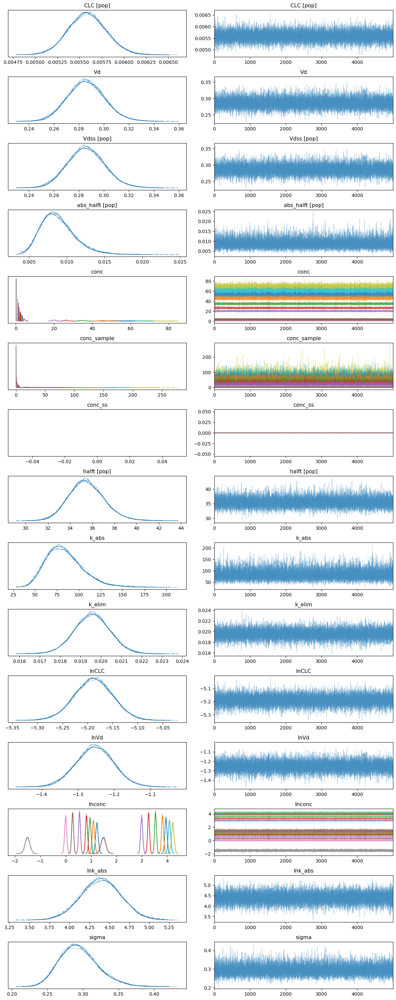

In [33]:
with pfas_male_1cmpt_mouse.model:
    az.plot_trace(pfas_male_1cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


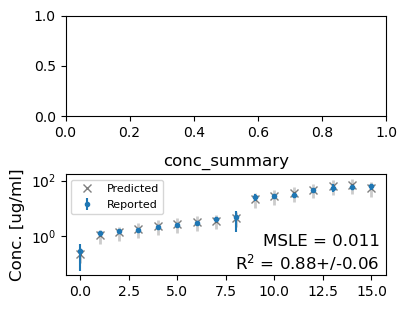

In [34]:
pfas_male_1cmpt_mouse.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [35]:
pfas_male_2cmpt_mouse = PyPKMC(pfas_male_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior, pop_SD_prior=0.2)
pfas_male_2cmpt_mouse.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=12000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOS_Male_mouse_2cmpt
single level model, 2-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnR, lnVdss, lnk_abs, lnk_cd, sigma]


  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

  0%|          | 0/17000 [00:00<?, ?it/s]

There were 2 divergences after tuning. Increase `target_accept` or reparameterize.
Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = False
Assign pareto...


/data/tzurlind/Desktop/PKWG/manuscript_code/animal_pfas_manuscript/pfas_notebooks/../PyPKMC.py:1025: UserWarning: There were 2 divergences after tuning. Increase `target_accept` or reparameterize.
  warnings.warn(msg)


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


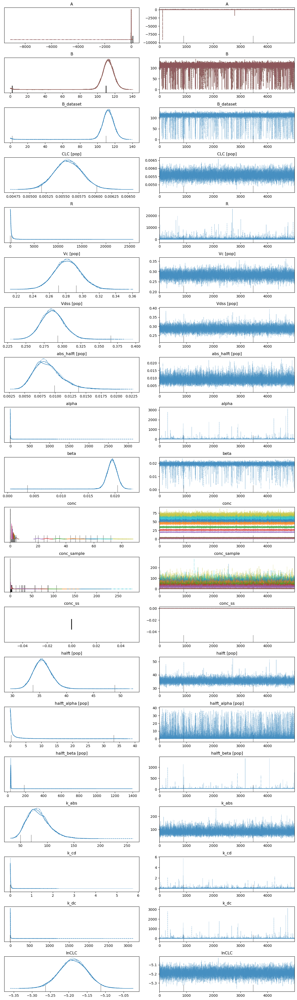

In [36]:
with pfas_male_2cmpt_mouse.model:
    az.plot_trace(pfas_male_2cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


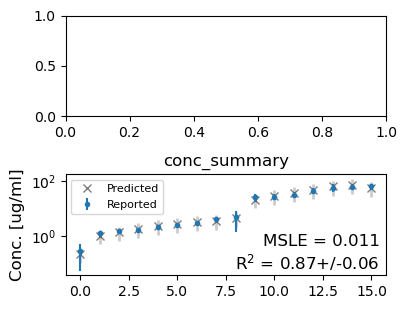

In [37]:
pfas_male_2cmpt_mouse.plot_data_ppc(group='posterior')

#### Compare models

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
1_compartment,0,-138.122235,4.808287,0.000000,1.0,25.086411,0.000000,False,log
2_compartment,1,-138.250954,4.897274,0.128719,0.0,25.111951,0.091335,False,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

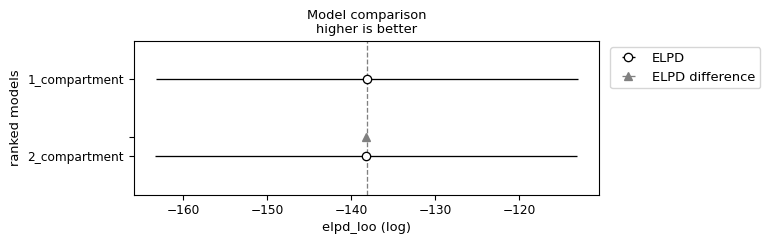

In [38]:
pfas_male_mouse_compare = az.compare({"1_compartment": pfas_male_1cmpt_mouse._trace, "2_compartment": pfas_male_2cmpt_mouse._trace},
                           var_name="combined",ic='loo')
display(pfas_male_mouse_compare)
az.plot_compare(pfas_male_mouse_compare, insample_dev=False)

#### Define winning model

In [89]:
pfas_male_mouse = pfas_male_1cmpt_mouse
print(pfas_male_mouse.N_divergences)
print(f'Pass all metrics = {pfas_male_mouse.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


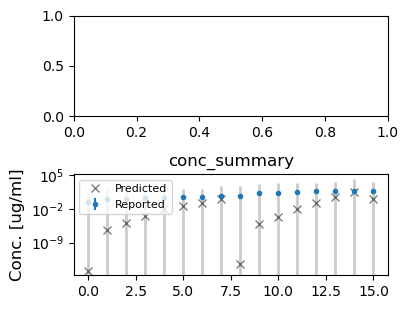

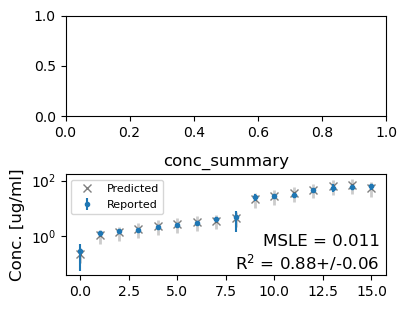

In [40]:
pfas_male_mouse.plot_data_ppc(group='prior', savefig=True)
pfas_male_mouse.plot_data_ppc(group='posterior', savefig=True)

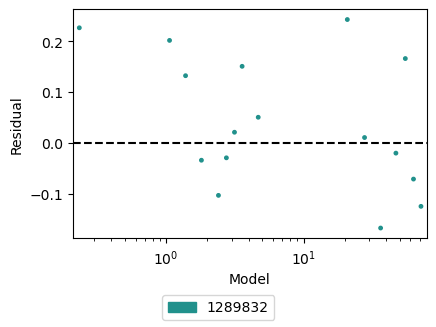

In [41]:
pfas_male_mouse.plot_residuals() 

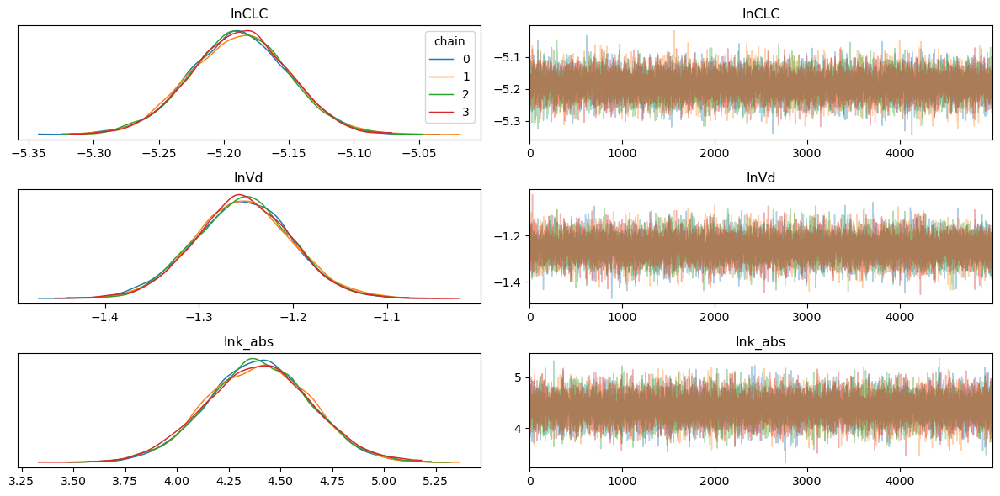

In [42]:
trace_model = pfas_male_mouse
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

Sampling: [conc_sample]


Output()

../species_fits/mouse/PFOS/PFOS_Male_mouse_CLC_1cmpt.pdf
Running PPC...
setting params...
sampling...


Calculating stats...


Sampling: [conc_sample]


Output()

Running PPC...
setting params...
sampling...


Calculating stats...


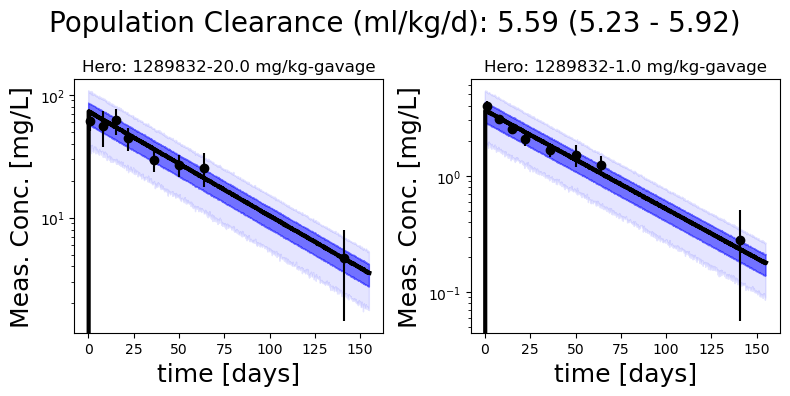

In [43]:
pfas_male_mouse.plot_all_studies()

### PK stats

In [44]:
pfas_male_mouse.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],0.00559,0.00021,0.00523,0.00592
Vdss [pop],0.28596,0.01487,0.26208,0.31052
abs_halft [pop],0.00882,0.00224,0.00522,0.01221
halft [pop],35.49052,1.59180,32.87877,38.05240


## Female

In [45]:
%%time
pfas_female_data_mouse = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='mouse')
pfas_female_data_mouse.head()

Hero ID available:  [1289832 3749289 3859701 5387170]
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
No BW info for mouse in 1289832, using defaults
dropping duplicated column
Hero ID used:  [1289832]
CPU times: user 75.2 ms, sys: 4.96 ms, total: 80.2 ms
Wall time: 79.6 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,1289832,48,-1,4,-1.0,NaN,0.029,NaN,mouse,CD-1,1.0,mg/kg,1.0,day,3.775910,0.112045,1,ug/ml,gavage,serum,Female,DTXSID3031864,Figure 7,9.0,weeks,NaN,Not Reported,4,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,8,0,0,0,1.0,1.0,0.029,3.775910,0.224090,0.0,-1,0,1,1,0.059295,1.326884,0.059347,False,0.029,1289832-1.0 mg/kg-gavage
1,1289832,48,-1,4,-1.0,NaN,0.029,NaN,mouse,CD-1,1.0,mg/kg,8.0,day,4.201681,0.156863,1,ug/ml,gavage,serum,Female,DTXSID3031864,Figure 7,9.0,weeks,NaN,Not Reported,4,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,8,0,0,0,8.0,1.0,0.029,4.201681,0.313725,0.0,-1,0,1,1,0.074563,1.432705,0.074667,False,0.029,1289832-1.0 mg/kg-gavage
2,1289832,48,-1,4,-1.0,NaN,0.029,NaN,mouse,CD-1,1.0,mg/kg,15.0,day,2.812325,0.112045,1,ug/ml,gavage,serum,Female,DTXSID3031864,Figure 7,9.0,weeks,NaN,Not Reported,4,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,8,0,0,0,15.0,1.0,0.029,2.812325,0.224090,0.0,-1,0,1,1,0.079555,1.030847,0.079681,False,0.029,1289832-1.0 mg/kg-gavage
3,1289832,48,-1,4,-1.0,NaN,0.029,NaN,mouse,CD-1,1.0,mg/kg,22.0,day,2.655462,0.268908,1,ug/ml,gavage,serum,Female,DTXSID3031864,Figure 7,9.0,weeks,NaN,Not Reported,4,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,8,0,0,0,22.0,1.0,0.029,2.655462,0.537815,0.0,-1,0,1,1,0.200500,0.956519,0.202532,False,0.029,1289832-1.0 mg/kg-gavage
4,1289832,48,-1,4,-1.0,NaN,0.029,NaN,mouse,CD-1,1.0,mg/kg,36.0,day,1.490196,0.134454,1,ug/ml,gavage,serum,Female,DTXSID3031864,Figure 7,9.0,weeks,NaN,Not Reported,4,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,8,0,0,0,36.0,1.0,0.029,1.490196,0.268908,0.0,-1,0,1,1,0.179007,0.382886,0.180451,False,0.029,1289832-1.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [46]:
pfas_female_1cmpt_mouse = PyPKMC(pfas_female_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt_mouse.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOS_Female_mouse_1cmpt
single level model, 1-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnVd, lnk_abs, sigma]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


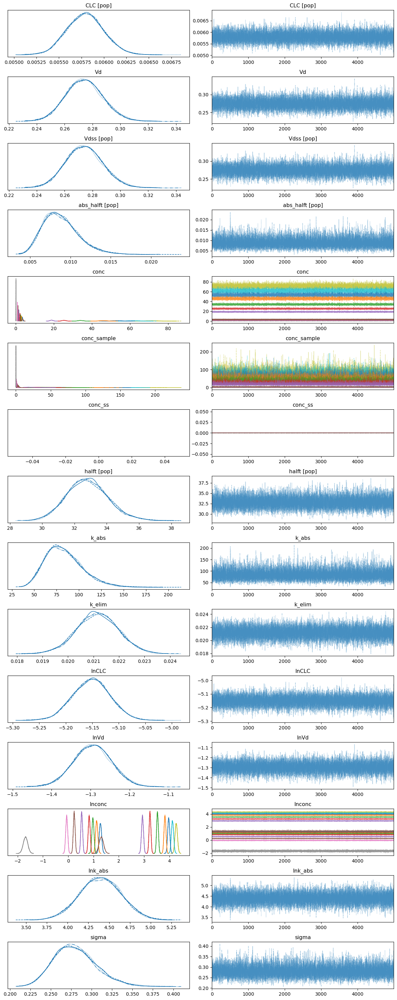

In [47]:
with pfas_female_1cmpt_mouse.model:
    az.plot_trace(pfas_female_1cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


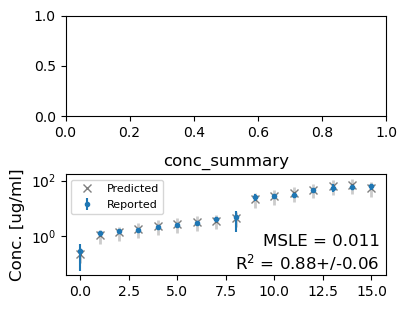

In [48]:
pfas_male_1cmpt_mouse.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [49]:
pfas_female_2cmpt_mouse = PyPKMC(pfas_female_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt_mouse.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOS_Female_mouse_2cmpt
single level model, 2-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnR, lnVdss, lnk_abs, lnk_cd, sigma]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

There were 7 divergences after tuning. Increase `target_accept` or reparameterize.
Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Checking metrics...
Pass all metrics = False
Assign pareto...


/data/tzurlind/Desktop/PKWG/manuscript_code/animal_pfas_manuscript/pfas_notebooks/../PyPKMC.py:1025: UserWarning: There were 7 divergences after tuning. Increase `target_accept` or reparameterize.
  warnings.warn(msg)


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


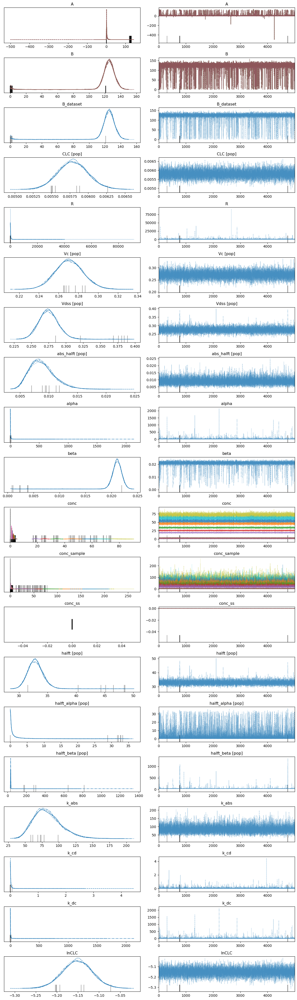

In [50]:
with pfas_female_2cmpt_mouse.model:
    az.plot_trace(pfas_female_2cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


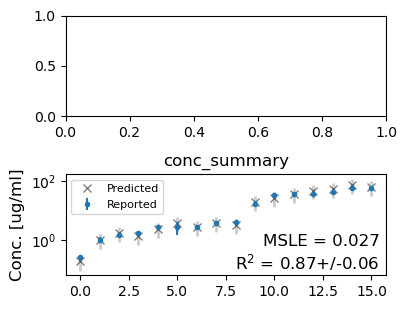

In [51]:
pfas_female_2cmpt_mouse.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
1_compartment,0,-137.370464,10.646825,0.000000,1.0,25.629136,0.000000,True,log
2_compartment,1,-138.302569,11.536650,0.932105,0.0,25.778950,0.670758,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

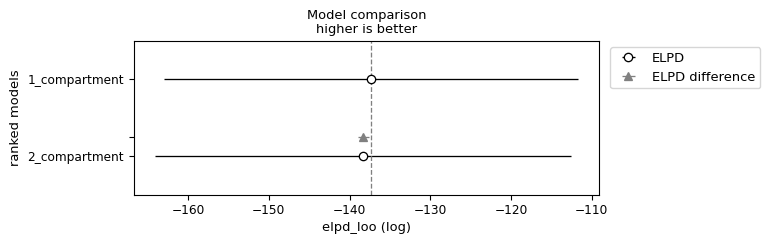

In [52]:
pfas_female_mouse_compare = az.compare({"1_compartment": pfas_female_1cmpt_mouse._trace, "2_compartment": pfas_female_2cmpt_mouse._trace},
                           var_name="combined",ic='loo')
display(pfas_female_mouse_compare)
az.plot_compare(pfas_female_mouse_compare, insample_dev=False)

#### Define winning model

In [90]:
pfas_female_mouse = pfas_female_1cmpt_mouse
print(pfas_female_mouse.N_divergences)
print(f'Pass all metrics = {pfas_female_mouse.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


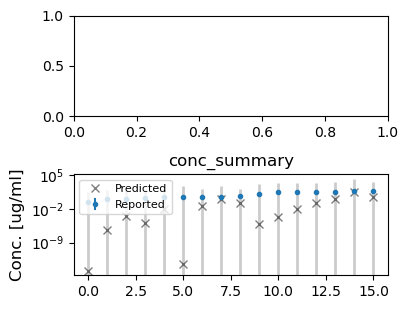

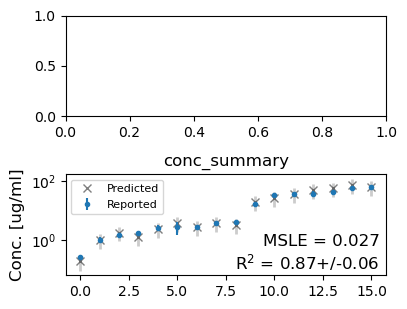

In [54]:
pfas_female_mouse.plot_data_ppc(group='prior', savefig=True)
pfas_female_mouse.plot_data_ppc(group='posterior', savefig=True)

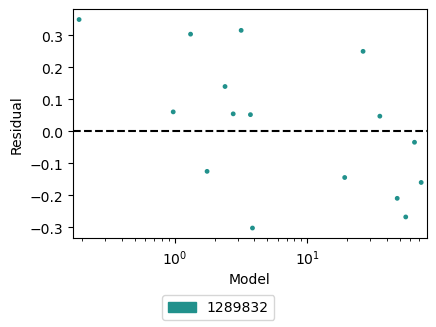

In [55]:
pfas_female_mouse.plot_residuals() 

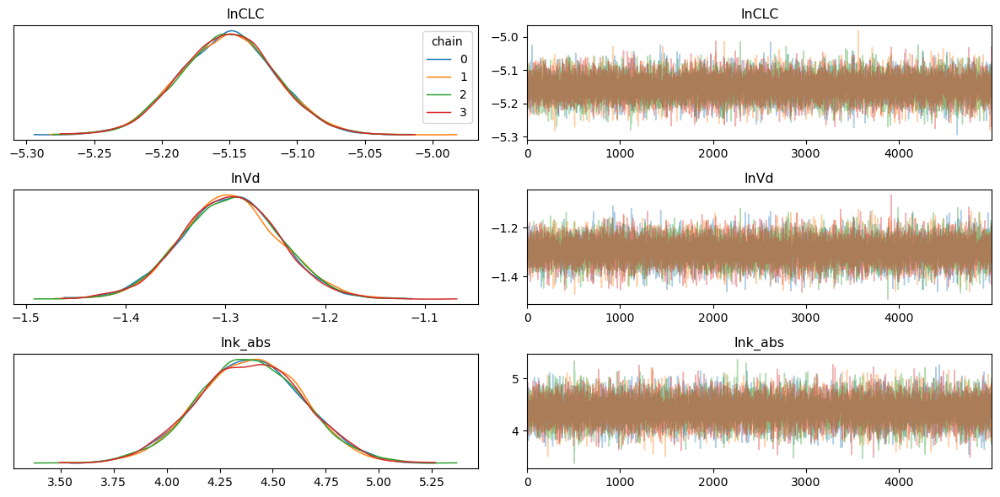

In [56]:
trace_model = pfas_female_mouse
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

Sampling: [conc_sample]


Output()

../species_fits/mouse/PFOS/PFOS_Female_mouse_CLC_1cmpt.pdf
Running PPC...
setting params...
sampling...


Calculating stats...


Sampling: [conc_sample]


Output()

Running PPC...
setting params...
sampling...


Calculating stats...


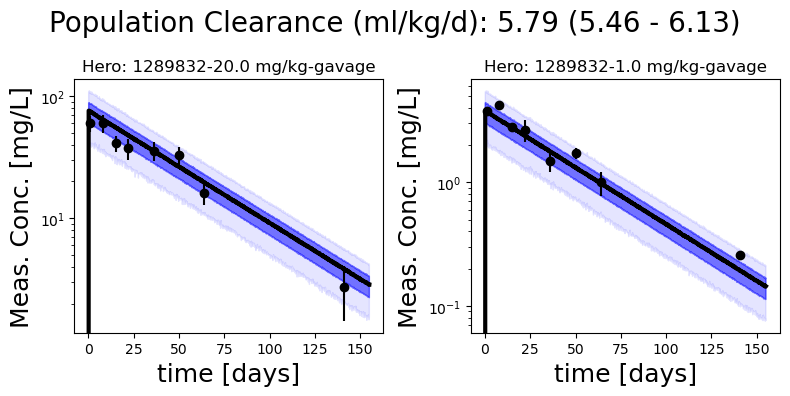

In [57]:
pfas_female_mouse.plot_all_studies()

### PK stats

In [58]:
pfas_female_mouse.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],0.00579,0.00020,0.00546,0.00613
Vdss [pop],0.27423,0.01344,0.25271,0.29658
abs_halft [pop],0.00883,0.00223,0.00529,0.01224
halft [pop],32.80985,1.27935,30.69206,34.86075


# Primate

## Male

In [59]:
%%time
pfas_male_data_primate = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='primate')
pfas_male_data_primate.head()

Hero ID available:  [1289832 3749289 3859701 5387170]
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defau

,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,1289832,49,M2053,1,-1.0,NaN,2.6,NaN,primate,cynomolgus,2.0,mg/kg,0.5,hour,16.087604,0.0,0,ug/ml,iv,serum,Male,DTXSID3031864,Figure 11,2.75,years,NaN,Not Reported,1,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,15,0,0,0,0.020833,2.0,2.6,16.087604,0.0,0.0,-1,0,0,0,0.0,2.778049,0.0,True,5.2,1289832-2.0 mg/kg-iv
1,1289832,49,M2054,1,-1.0,NaN,2.6,NaN,primate,cynomolgus,2.0,mg/kg,0.5,hour,14.747509,0.0,0,ug/ml,iv,serum,Male,DTXSID3031864,Figure 11,2.75,years,NaN,Not Reported,1,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,15,0,0,0,0.020833,2.0,2.6,14.747509,0.0,0.0,-1,0,0,0,0.0,2.691074,0.0,True,5.2,1289832-2.0 mg/kg-iv
2,1289832,49,M2211,1,-1.0,NaN,2.6,NaN,primate,cynomolgus,2.0,mg/kg,0.5,hour,16.577239,0.0,0,ug/ml,iv,serum,Male,DTXSID3031864,Figure 11,2.75,years,NaN,Not Reported,1,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,15,0,0,0,0.020833,2.0,2.6,16.577239,0.0,0.0,-1,0,0,0,0.0,2.808031,0.0,True,5.2,1289832-2.0 mg/kg-iv
3,1289832,49,M2053,1,-1.0,NaN,2.6,NaN,primate,cynomolgus,2.0,mg/kg,2.0,hour,11.288880,0.0,0,ug/ml,iv,serum,Male,DTXSID3031864,Figure 11,2.75,years,NaN,Not Reported,1,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,15,0,0,0,0.083333,2.0,2.6,11.288880,0.0,0.0,-1,0,0,0,0.0,2.423818,0.0,True,5.2,1289832-2.0 mg/kg-iv
4,1289832,49,M2054,1,-1.0,NaN,2.6,NaN,primate,cynomolgus,2.0,mg/kg,2.0,hour,13.695887,0.0,0,ug/ml,iv,serum,Male,DTXSID3031864,Figure 11,2.75,years,NaN,Not Reported,1,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,15,0,0,0,0.083333,2.0,2.6,13.695887,0.0,0.0,-1,0,0,0,0.0,2.617096,0.0,True,5.2,1289832-2.0 mg/kg-iv


### Run the models

#### 1-Compartment model

In [60]:
pfas_male_1cmpt_primate = PyPKMC(pfas_male_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt_primate.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOS_Male_primate_1cmpt
single level model, 1-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnVd, lnk_abs, sigma]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


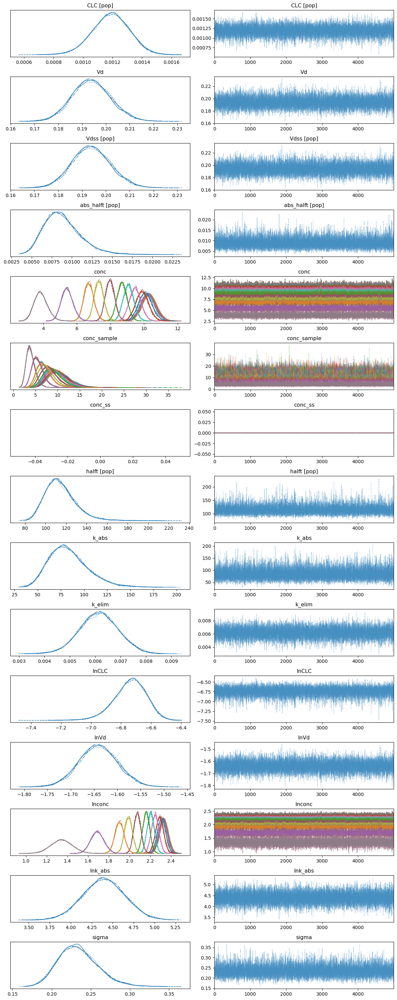

In [61]:
with pfas_male_1cmpt_primate.model:
    az.plot_trace(pfas_male_1cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


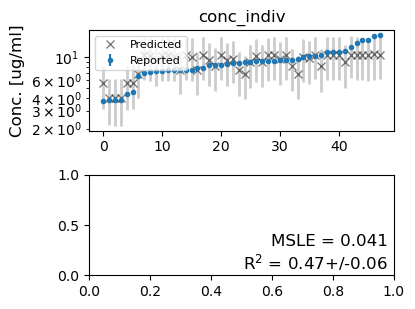

In [62]:
pfas_male_1cmpt_primate.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [93]:
pfas_male_2cmpt_primate = PyPKMC(pfas_male_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_2cmpt_primate.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOS_Male_primate_2cmpt
single level model, 2-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnR, lnVdss, lnk_abs, lnk_cd, sigma]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


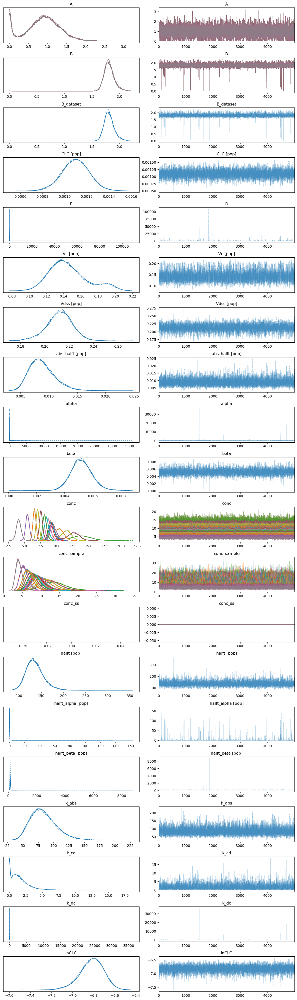

In [94]:
with pfas_male_2cmpt_primate.model:
    az.plot_trace(pfas_male_2cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


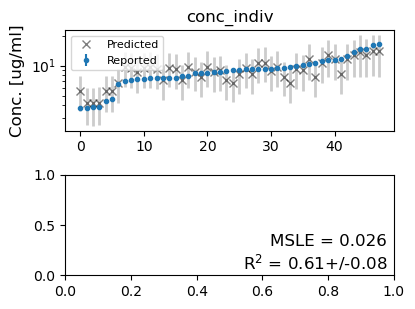

In [95]:
pfas_male_2cmpt_primate.plot_data_ppc(group='posterior')

#### Compare models

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-93.996840,4.710819,0.000000,1.000000e+00,4.685463,0.000000,False,log
1_compartment,1,-101.682159,2.262913,7.685319,8.437695e-14,5.110771,3.094133,False,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

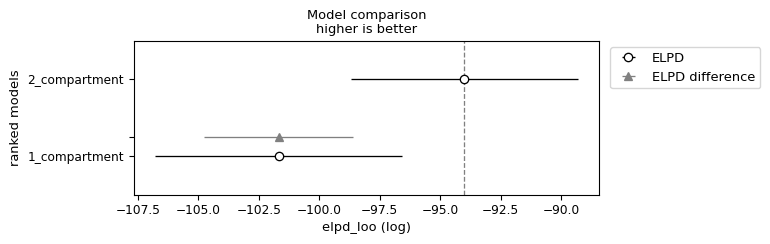

In [96]:
pfas_male_primate_compare = az.compare({"1_compartment": pfas_male_1cmpt_primate._trace, "2_compartment": pfas_male_2cmpt_primate._trace},
                           var_name="combined",ic='loo')
display(pfas_male_primate_compare)
az.plot_compare(pfas_male_primate_compare, insample_dev=False)

#### Define winning model

In [97]:
pfas_male_primate = pfas_male_2cmpt_primate
print(pfas_male_primate.N_divergences)
print(f'Pass all metrics = {pfas_male_primate.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


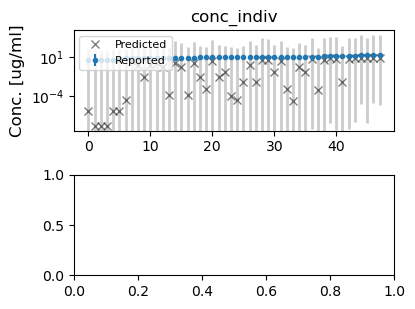

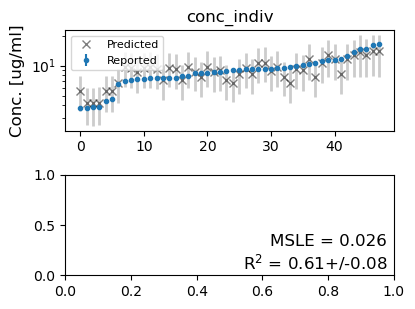

In [98]:
pfas_male_primate.plot_data_ppc(group='prior', savefig=True)
pfas_male_primate.plot_data_ppc(group='posterior', savefig=True)

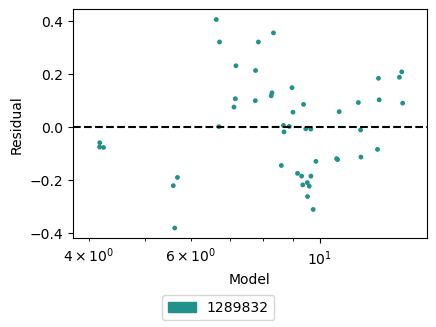

In [99]:
pfas_male_primate.plot_residuals() 

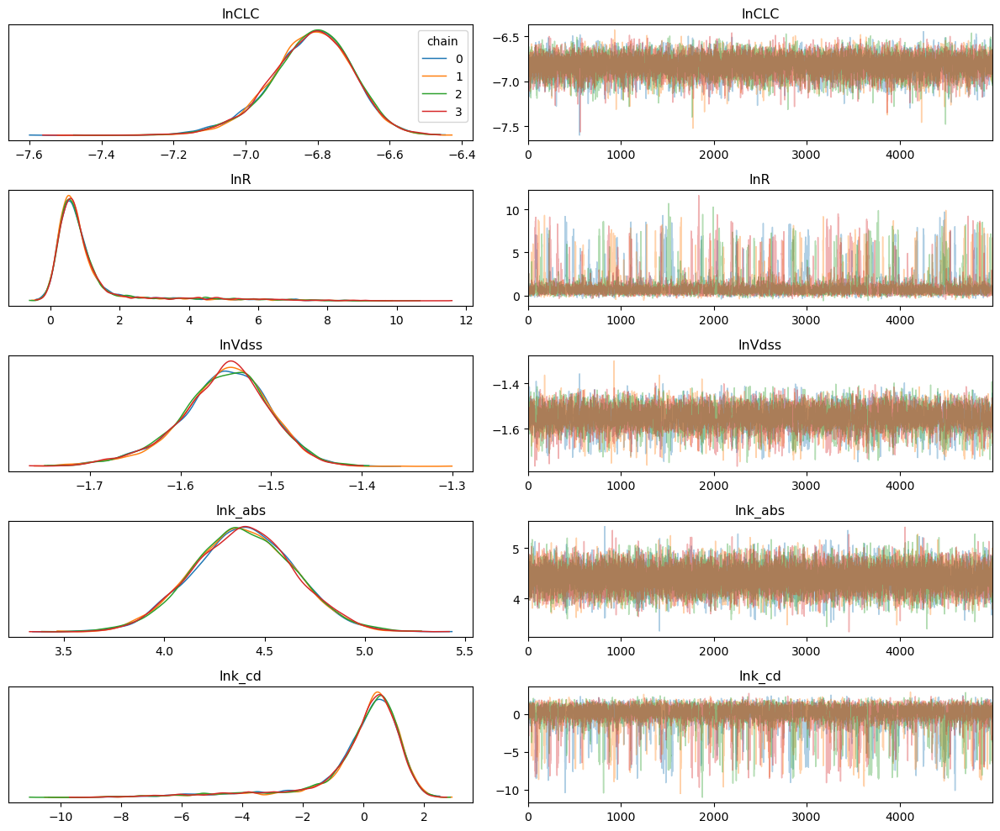

In [100]:
trace_model = pfas_male_primate
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/primate/PFOS/PFOS_Male_primate_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


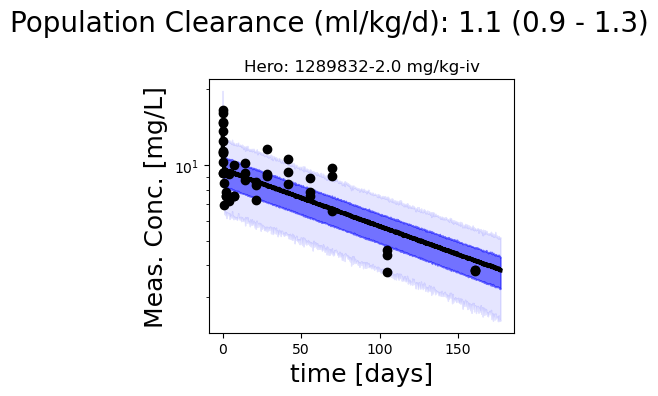

In [101]:
pfas_male_primate.plot_all_studies()

### PK stats

In [102]:
pfas_male_primate.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],0.00110,0.00012,0.00090,0.00130
Vc [pop],0.14546,0.02247,0.11141,0.18831
Vdss [pop],0.21206,0.01064,0.19468,0.22967
abs_halft [pop],0.00883,0.00225,0.00523,0.01229
halft [pop],135.88813,20.31265,104.41188,167.86003
halft_alpha [pop],0.62182,4.83353,0.00002,0.47977
halft_beta [pop],136.73677,67.37202,104.31135,168.00751


## Female

In [73]:
%%time
pfas_female_data_primate = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='primate')
pfas_female_data_primate.head()

Hero ID available:  [1289832 3749289 3859701 5387170]
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defaults
No BW info for primate in 1289832, using defau

,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,1289832,50,F2058,1,-1.0,NaN,2.5,NaN,primate,cynomolgus,2.0,mg/kg,0.5,hour,10.298184,0.0,0,ug/ml,iv,serum,Female,DTXSID3031864,Figure 11,2.75,years,NaN,Not Reported,1,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,15,0,0,0,0.020833,2.0,2.5,10.298184,0.0,0.0,-1,0,0,1,0.0,2.331968,0.0,True,5.0,1289832-2.0 mg/kg-iv
1,1289832,50,F2061,1,-1.0,NaN,2.5,NaN,primate,cynomolgus,2.0,mg/kg,0.5,hour,12.876090,0.0,0,ug/ml,iv,serum,Female,DTXSID3031864,Figure 11,2.75,years,NaN,Not Reported,1,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,15,0,0,0,0.020833,2.0,2.5,12.876090,0.0,0.0,-1,0,0,1,0.0,2.555372,0.0,True,5.0,1289832-2.0 mg/kg-iv
2,1289832,50,F2058,1,-1.0,NaN,2.5,NaN,primate,cynomolgus,2.0,mg/kg,2.0,hour,8.060681,0.0,0,ug/ml,iv,serum,Female,DTXSID3031864,Figure 11,2.75,years,NaN,Not Reported,1,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,15,0,0,0,0.083333,2.0,2.5,8.060681,0.0,0.0,-1,0,0,1,0.0,2.086998,0.0,True,5.0,1289832-2.0 mg/kg-iv
3,1289832,50,F2059,1,-1.0,NaN,2.5,NaN,primate,cynomolgus,2.0,mg/kg,2.0,hour,11.418608,0.0,0,ug/ml,iv,serum,Female,DTXSID3031864,Figure 11,2.75,years,NaN,Not Reported,1,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,15,0,0,0,0.083333,2.0,2.5,11.418608,0.0,0.0,-1,0,0,1,0.0,2.435244,0.0,True,5.0,1289832-2.0 mg/kg-iv
4,1289832,50,F2061,1,-1.0,NaN,2.5,NaN,primate,cynomolgus,2.0,mg/kg,2.0,hour,11.725311,0.0,0,ug/ml,iv,serum,Female,DTXSID3031864,Figure 11,2.75,years,NaN,Not Reported,1,Chang,Perfluorooctanesulfonic acid,PFOS,1763-23-1,"1,1,2,2,3,3,4,4,5,5,6,6,7,7,8,8,8-heptadecaflu...",DTXSID3031864,15,0,0,0,0.083333,2.0,2.5,11.725311,0.0,0.0,-1,0,0,1,0.0,2.461750,0.0,True,5.0,1289832-2.0 mg/kg-iv


### Run the models

#### 1-Compartment model

In [74]:
pfas_female_1cmpt_primate = PyPKMC(pfas_female_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt_primate.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOS_Female_primate_1cmpt
single level model, 1-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnVd, lnk_abs, sigma]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


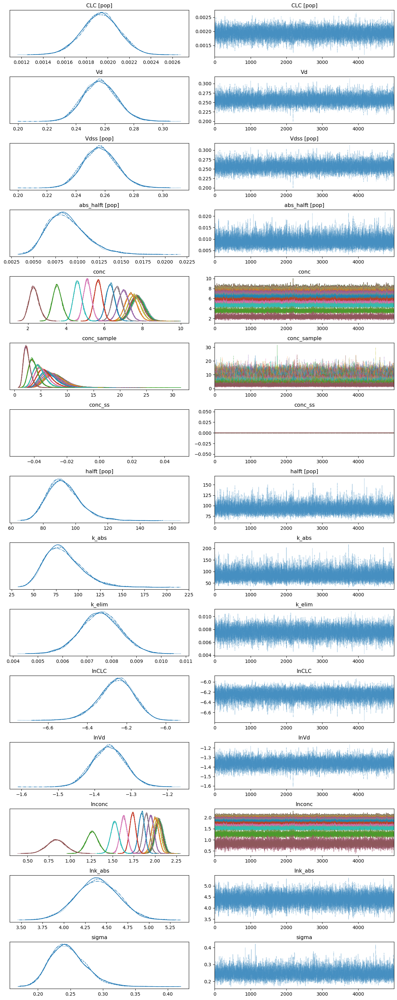

In [75]:
with pfas_female_1cmpt_primate.model:
    az.plot_trace(pfas_female_1cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


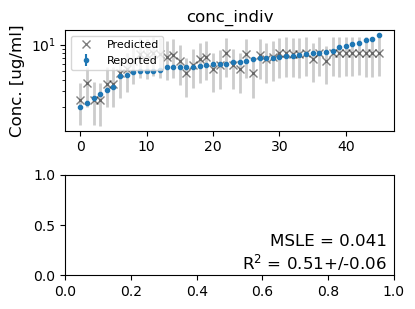

In [76]:
pfas_female_1cmpt_primate.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [77]:
pfas_female_2cmpt_primate = PyPKMC(pfas_female_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt_primate.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFOS_Female_primate_2cmpt
single level model, 2-compartment


Sampling: [conc_indiv, conc_summary, lnCLC, lnR, lnVdss, lnk_abs, lnk_cd, sigma]


  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

  0%|          | 0/15000 [00:00<?, ?it/s]

Sampling: [conc_indiv, conc_summary]


Output()

Combining likelihoods...
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


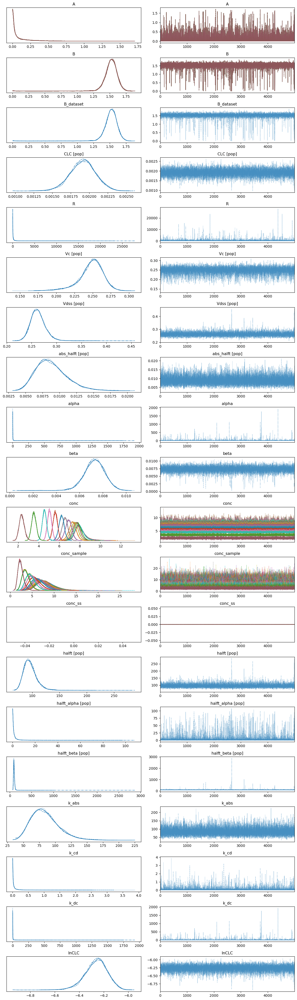

In [78]:
with pfas_female_2cmpt_primate.model:
    az.plot_trace(pfas_female_2cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


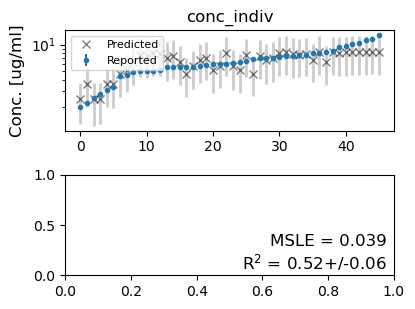

In [79]:
pfas_female_2cmpt_primate.plot_data_ppc(group='posterior')

#### Compare models

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-83.691125,3.093780,0.000000,1.0,4.974279,0.000000,False,log
1_compartment,1,-84.523866,2.547315,0.832741,0.0,5.062345,0.475491,False,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

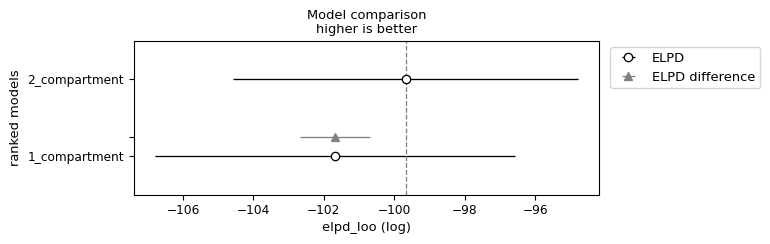

In [80]:
pfas_female_primate_compare = az.compare({"1_compartment": pfas_female_1cmpt_primate._trace, "2_compartment": pfas_female_2cmpt_primate._trace},
                           var_name="combined",ic='loo')
display(pfas_female_primate_compare)
az.plot_compare(pfas_male_primate_compare, insample_dev=False)

#### Define winning model

In [91]:
pfas_female_primate = pfas_female_2cmpt_primate
print(pfas_female_primate.N_divergences)
print(f'Pass all metrics = {pfas_female_primate.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


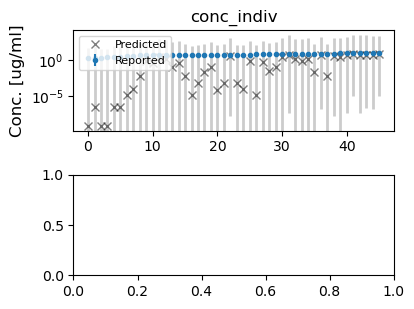

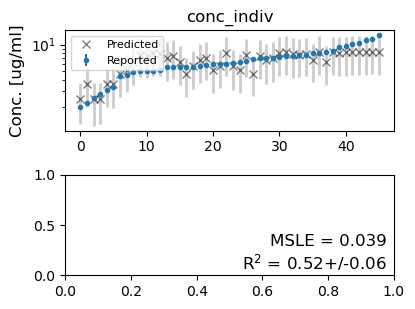

In [82]:
pfas_female_primate.plot_data_ppc(group='prior', savefig=True)
pfas_female_primate.plot_data_ppc(group='posterior', savefig=True)

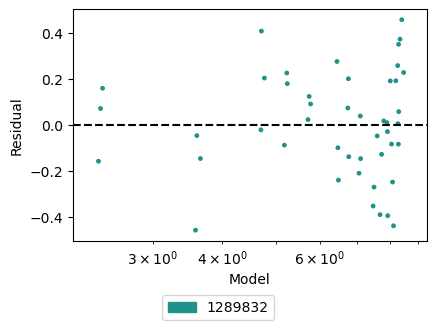

In [83]:
pfas_female_primate.plot_residuals() 

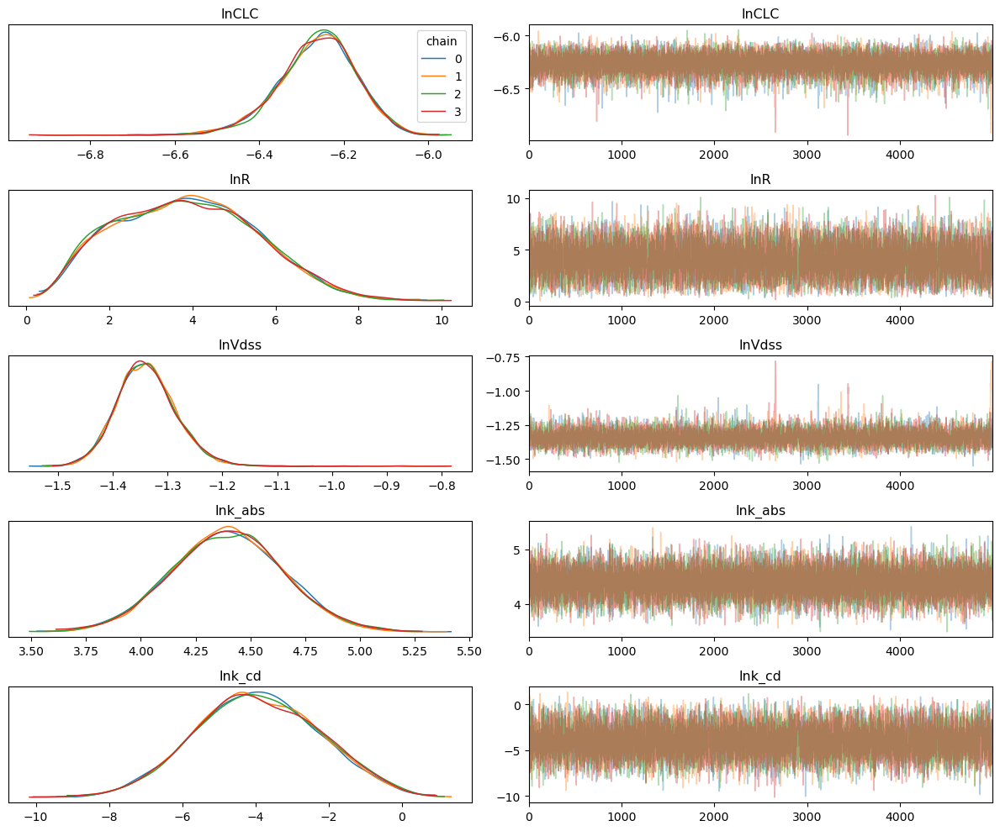

In [84]:
trace_model = pfas_female_primate
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/primate/PFOS/PFOS_Female_primate_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


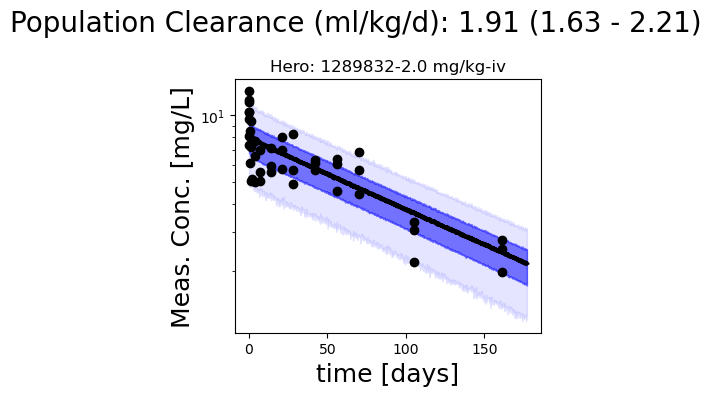

In [85]:
pfas_female_primate.plot_all_studies()

### PK stats

In [86]:
pfas_female_primate.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],0.00191,0.00018,0.00163,0.00220
Vc [pop],0.24801,0.01696,0.22096,0.27448
Vdss [pop],0.26285,0.01568,0.23983,0.28643
abs_halft [pop],0.00883,0.00227,0.00539,0.01251
halft [pop],96.30343,12.99389,77.88870,115.24981
halft_alpha [pop],2.86490,8.39950,0.00036,5.23158
halft_beta [pop],97.51467,30.38033,77.29320,115.43618
